# Install and Import required libraries and modules

In [ ]:
%pip install ultralytics

In [ ]:
# Import required modules and libraries

from ultralytics import YOLO
import cv2
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

print("Imports completed successfully.")

Imports completed successfully.


Load and Initialize YOLO Model

In [ ]:
# Load YOLOv11 Model

# Model path
model_path = "/content/best.pt"

# Load the YOLO model
model = YOLO(model_path)

print("YOLOv11 model loaded successfully.")


YOLOv11 model loaded successfully.


# Initial Frame Setup testing

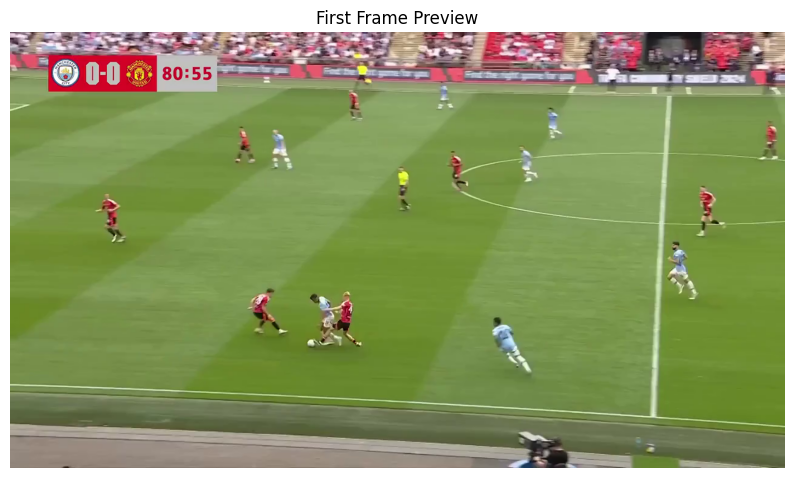

In [ ]:
# Load video & display first frame

video_path = "/content/15sec_input_720p.mp4"

cap = cv2.VideoCapture(video_path)

ret, frame = cap.read()

if ret:
    # Convert BGR to RGB for matplotlib
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 6))
    plt.imshow(frame_rgb)
    plt.title("First Frame Preview")
    plt.axis("off")
    plt.show()
else:
    print("Failed to read video.")

# Release for now
cap.release()



0: 384x640 1 ball, 16 players, 2 referees, 222.2ms
Speed: 22.5ms preprocess, 222.2ms inference, 352.2ms postprocess per image at shape (1, 3, 384, 640)


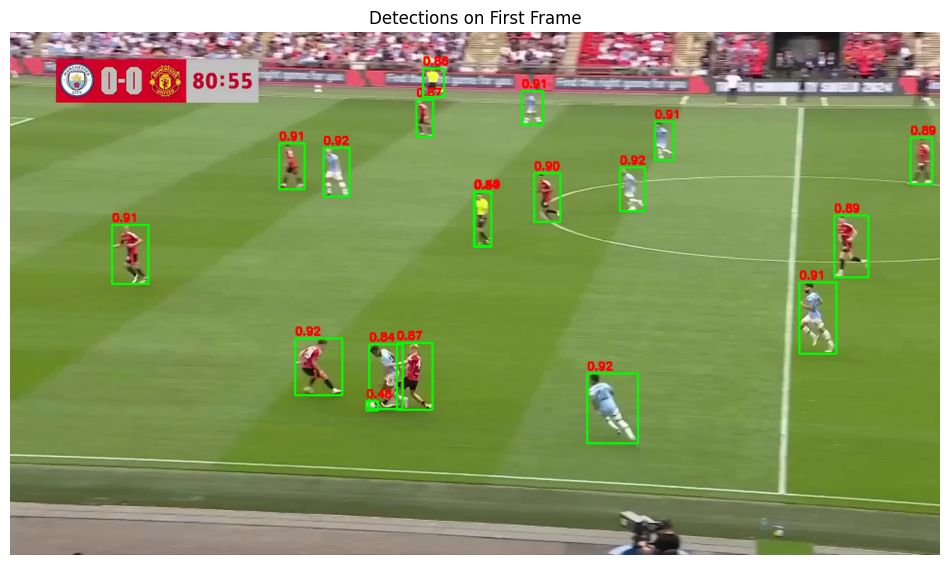

In [ ]:
# Run detection on first frame

# Reopen video to get the first frame again
cap = cv2.VideoCapture(video_path)
ret, frame = cap.read()
cap.release()

if ret:
    # Run YOLO detection
    results = model(frame)

    # Get boxes
    boxes = results[0].boxes.xyxy.cpu().numpy()  # shape: [N, 4]
    confidences = results[0].boxes.conf.cpu().numpy()

    # Draw each detected box
    for box, conf in zip(boxes, confidences):
        x1, y1, x2, y2 = box.astype(int)
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f"{conf:.2f}", (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

    # Convert to RGB for matplotlib
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(12, 8))
    plt.imshow(frame_rgb)
    plt.title("Detections on First Frame")
    plt.axis("off")
    plt.show()
else:
    print("Failed to read first frame.")



0: 384x640 1 ball, 16 players, 2 referees, 60.8ms
Speed: 2.4ms preprocess, 60.8ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


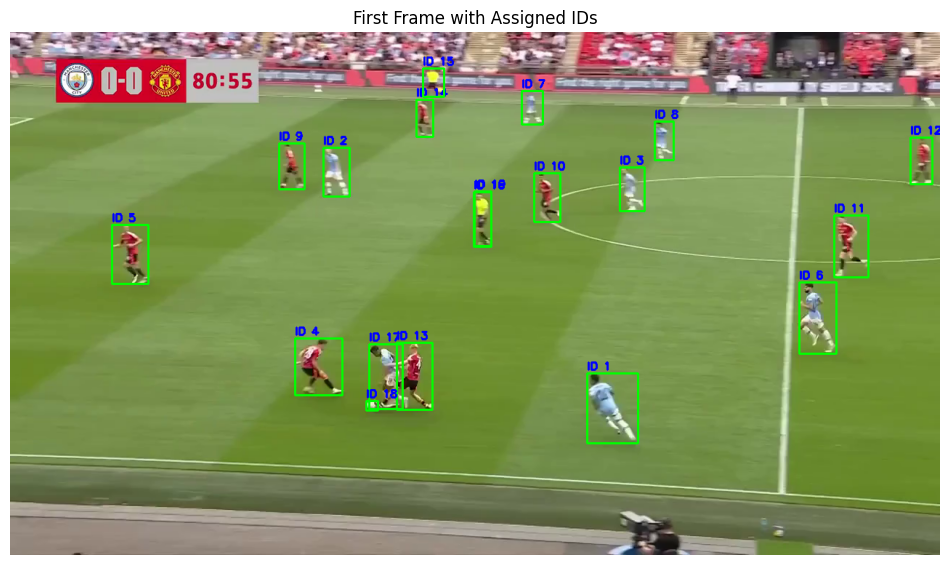

In [ ]:
# Assign IDs on first frame

# Reopen video to get first frame again
cap = cv2.VideoCapture(video_path)
ret, frame = cap.read()
cap.release()

if ret:
    results = model(frame)
    boxes = results[0].boxes.xyxy.cpu().numpy()
    confidences = results[0].boxes.conf.cpu().numpy()

    player_centers = []
    player_ids = []

    id_counter = 1

    for box in boxes:
        x1, y1, x2, y2 = box.astype(int)
        cx = int((x1 + x2) / 2)
        cy = int((y1 + y2) / 2)

        player_centers.append((cx, cy))
        player_ids.append(id_counter)

        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f"ID {id_counter}", (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

        id_counter += 1

    # Convert to RGB for matplotlib
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(12, 8))
    plt.imshow(frame_rgb)
    plt.title("First Frame with Assigned IDs")
    plt.axis("off")
    plt.show()

else:
    print("Failed to read first frame.")


# Re-ID across Video Frames

Simple re-ID across video (Re-Id approach 1)


0: 384x640 1 ball, 16 players, 2 referees, 73.3ms
Speed: 3.3ms preprocess, 73.3ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 73.9ms
Speed: 5.9ms preprocess, 73.9ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)


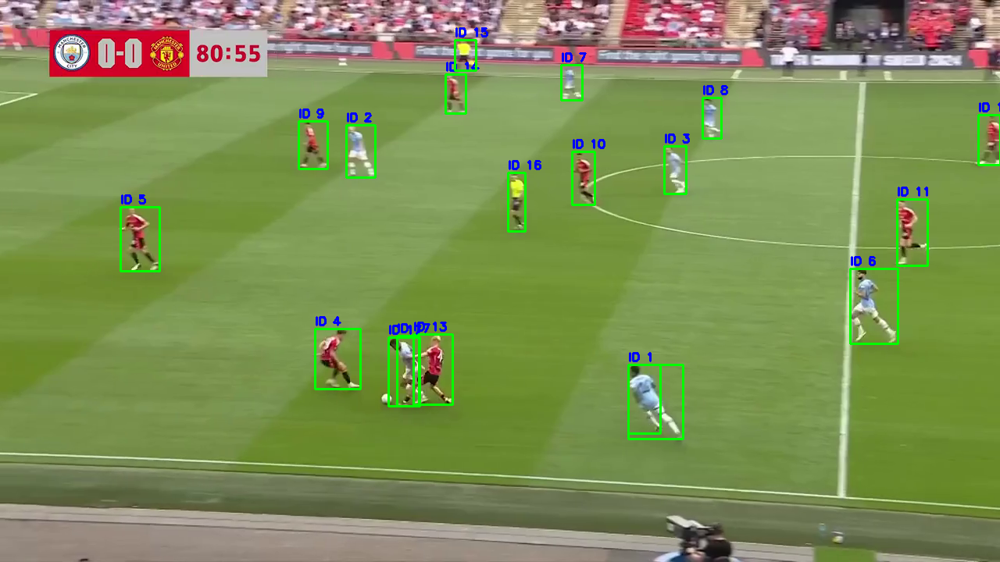


0: 384x640 1 ball, 16 players, 2 referees, 67.5ms
Speed: 2.3ms preprocess, 67.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


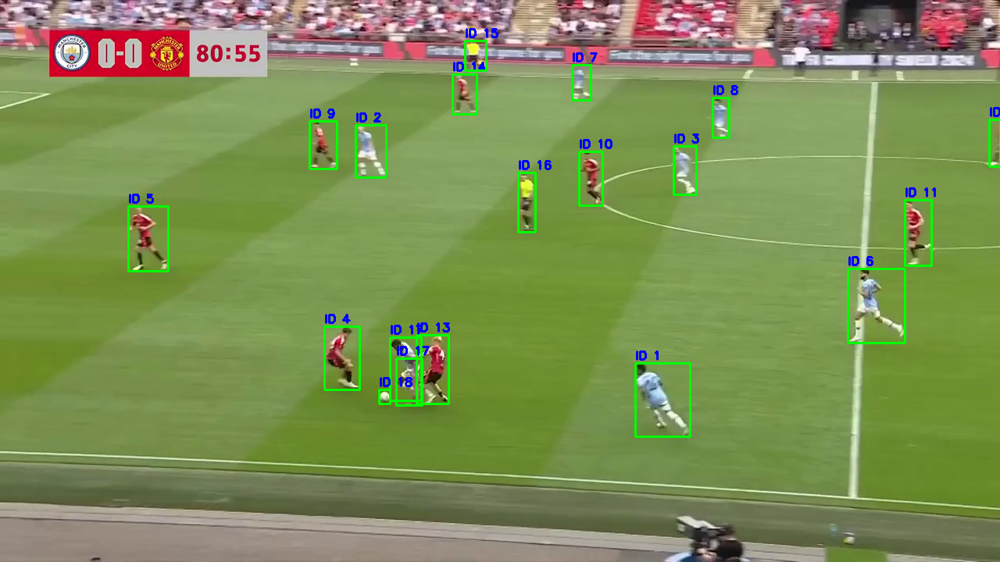


0: 384x640 1 ball, 14 players, 2 referees, 75.9ms
Speed: 3.4ms preprocess, 75.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


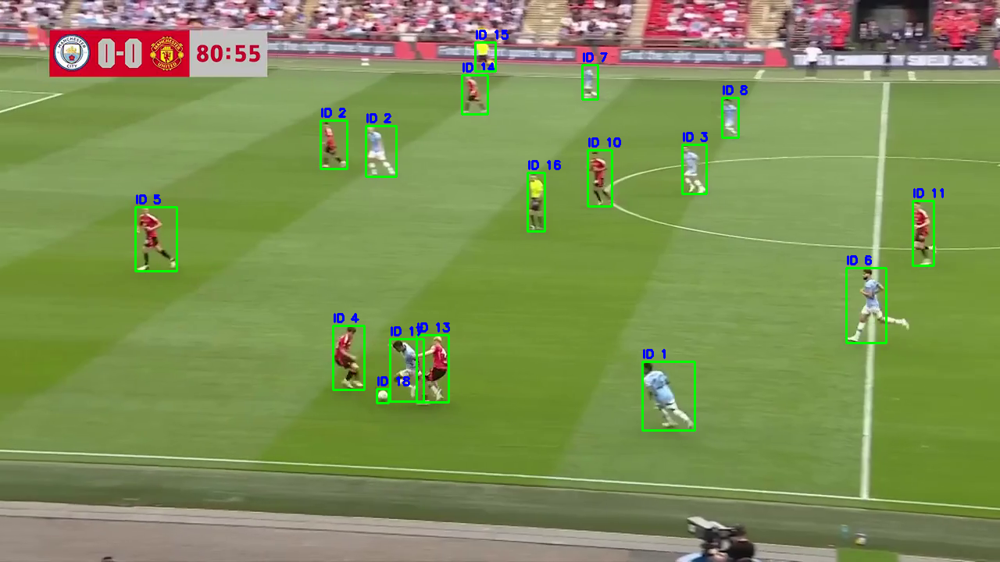


0: 384x640 1 ball, 14 players, 2 referees, 76.8ms
Speed: 2.5ms preprocess, 76.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


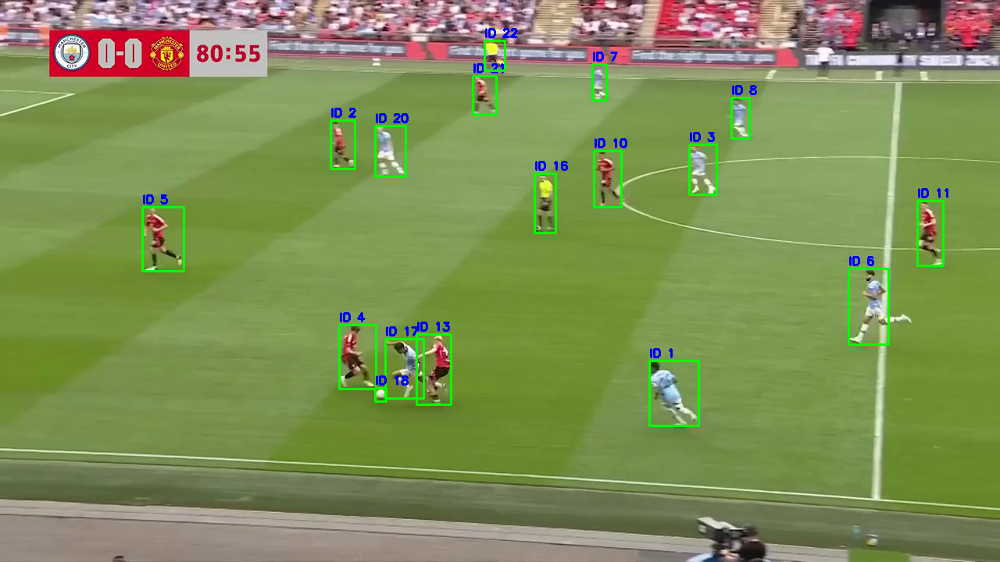


0: 384x640 1 ball, 16 players, 2 referees, 67.5ms
Speed: 4.2ms preprocess, 67.5ms inference, 14.5ms postprocess per image at shape (1, 3, 384, 640)


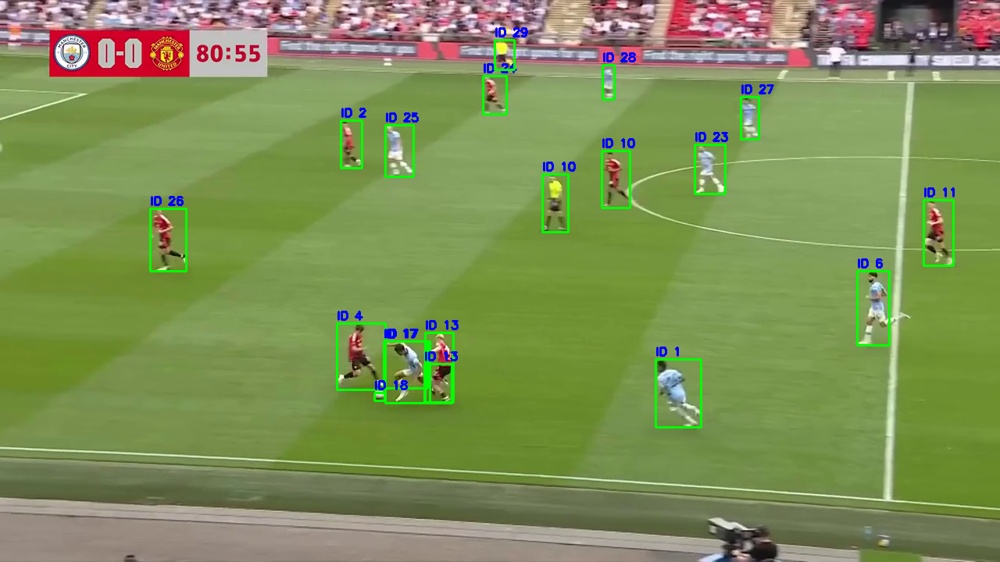


0: 384x640 15 players, 2 referees, 78.7ms
Speed: 2.5ms preprocess, 78.7ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 640)


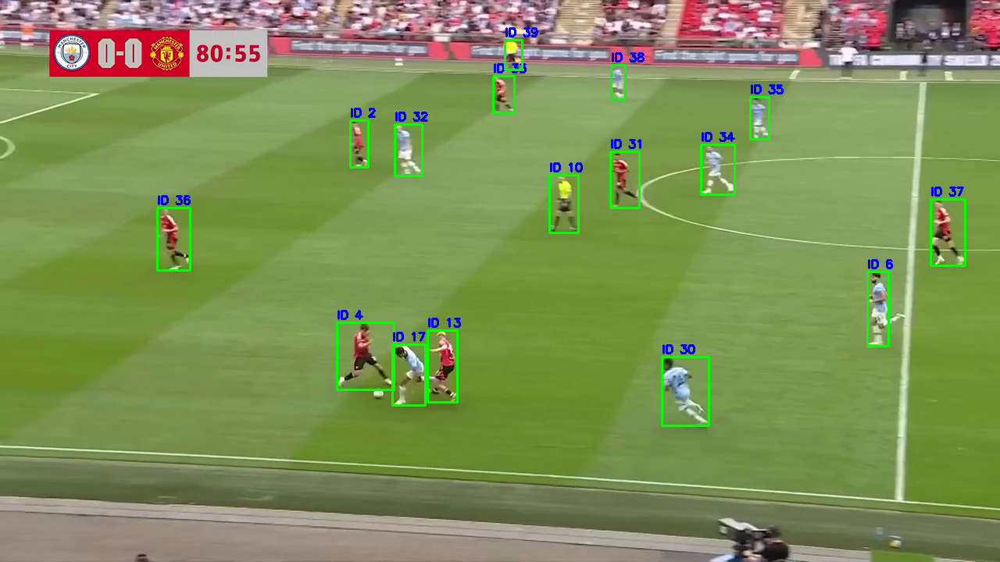


0: 384x640 15 players, 1 referee, 95.3ms
Speed: 2.5ms preprocess, 95.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


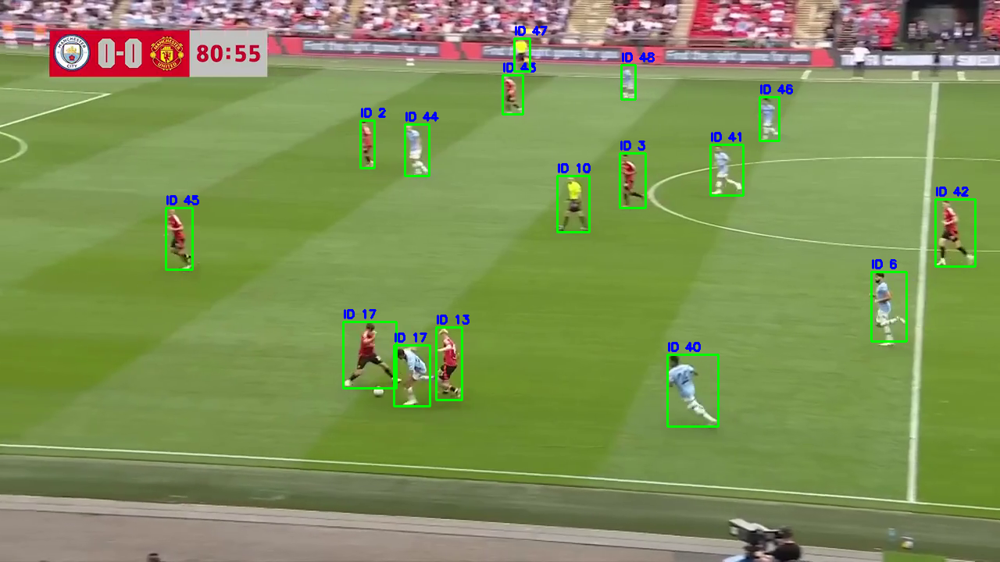


0: 384x640 1 ball, 16 players, 1 referee, 85.0ms
Speed: 3.0ms preprocess, 85.0ms inference, 20.4ms postprocess per image at shape (1, 3, 384, 640)


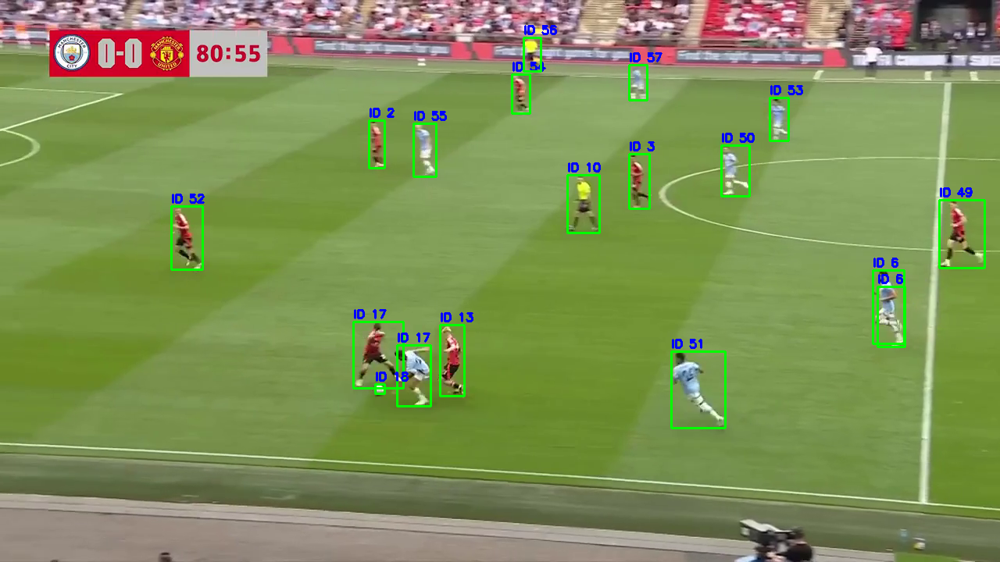


0: 384x640 1 ball, 15 players, 2 referees, 67.7ms
Speed: 2.4ms preprocess, 67.7ms inference, 4.1ms postprocess per image at shape (1, 3, 384, 640)


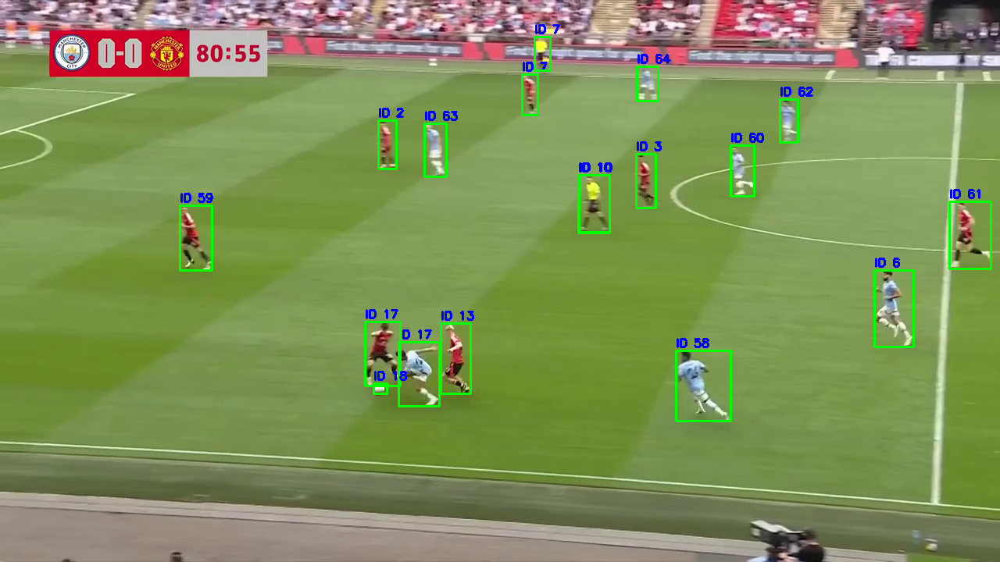


0: 384x640 1 ball, 15 players, 2 referees, 71.9ms
Speed: 4.6ms preprocess, 71.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


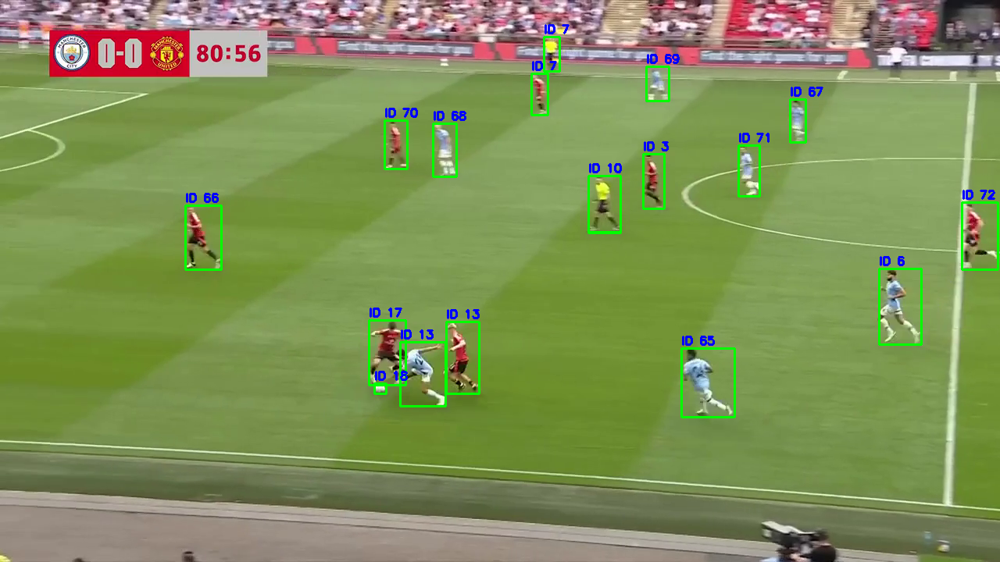


0: 384x640 1 ball, 15 players, 2 referees, 72.5ms
Speed: 2.5ms preprocess, 72.5ms inference, 41.9ms postprocess per image at shape (1, 3, 384, 640)


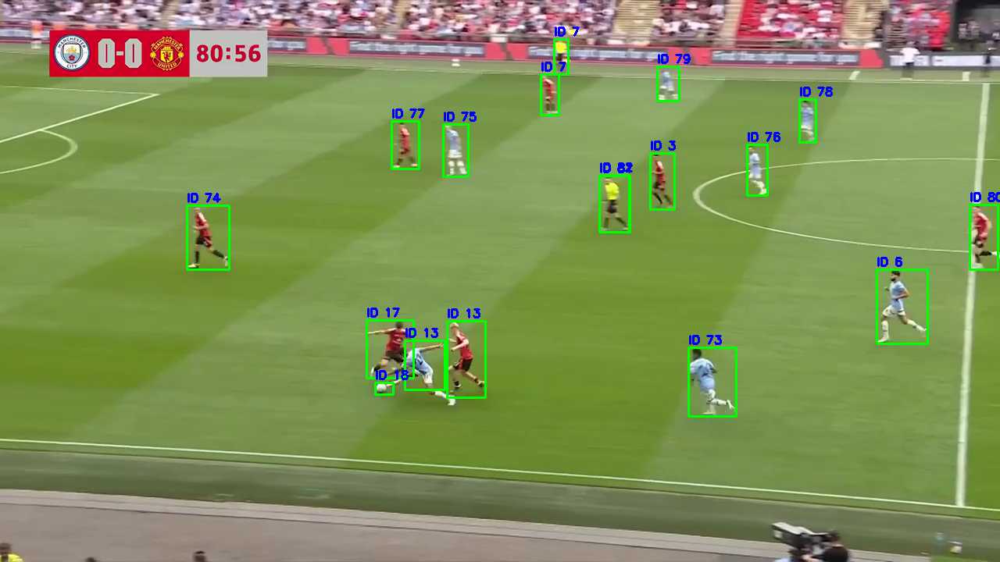

Re-ID demo completed for ~10 frames.


In [ ]:
# Simple re-ID across video

import math
from google.colab.patches import cv2_imshow

def euclidean_distance(p1, p2):
    return math.sqrt((p1[0] - p2[0])**2 + (p1[1] - p2[1])**2)

cap = cv2.VideoCapture(video_path)

ret, frame = cap.read()
if not ret:
    print("Could not read first frame.")
    cap.release()

results = model(frame)
boxes = results[0].boxes.xyxy.cpu().numpy()
player_centers = []
player_ids = []
id_counter = 1

for box in boxes:
    x1, y1, x2, y2 = box.astype(int)
    cx = int((x1 + x2) / 2)
    cy = int((y1 + y2) / 2)

    player_centers.append((cx, cy))
    player_ids.append(id_counter)
    id_counter += 1

frame_num = 0
while True:
    ret, frame = cap.read()
    if not ret or frame_num > 10:  # limit to 10 frames
        break

    results = model(frame)
    boxes = results[0].boxes.xyxy.cpu().numpy()

    new_centers = []
    new_ids = []

    for box in boxes:
        x1, y1, x2, y2 = box.astype(int)
        cx = int((x1 + x2) / 2)
        cy = int((y1 + y2) / 2)

        min_dist = float('inf')
        assigned_id = None
        for prev_c, prev_id in zip(player_centers, player_ids):
            dist = euclidean_distance((cx, cy), prev_c)
            if dist < min_dist and dist < 50:
                min_dist = dist
                assigned_id = prev_id

        if assigned_id is None:
            assigned_id = id_counter
            id_counter += 1

        new_centers.append((cx, cy))
        new_ids.append(assigned_id)

        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f"ID {assigned_id}", (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Show result frame using cv2_imshow
    cv2_imshow(frame)

    frame_num += 1

cap.release()
print("Re-ID demo completed for ~10 frames.")


Re-ID with Hungarian matching (Re-Id approach 2)


0: 384x640 1 ball, 16 players, 2 referees, 67.0ms
Speed: 3.7ms preprocess, 67.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 18 players, 2 referees, 63.3ms
Speed: 2.3ms preprocess, 63.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


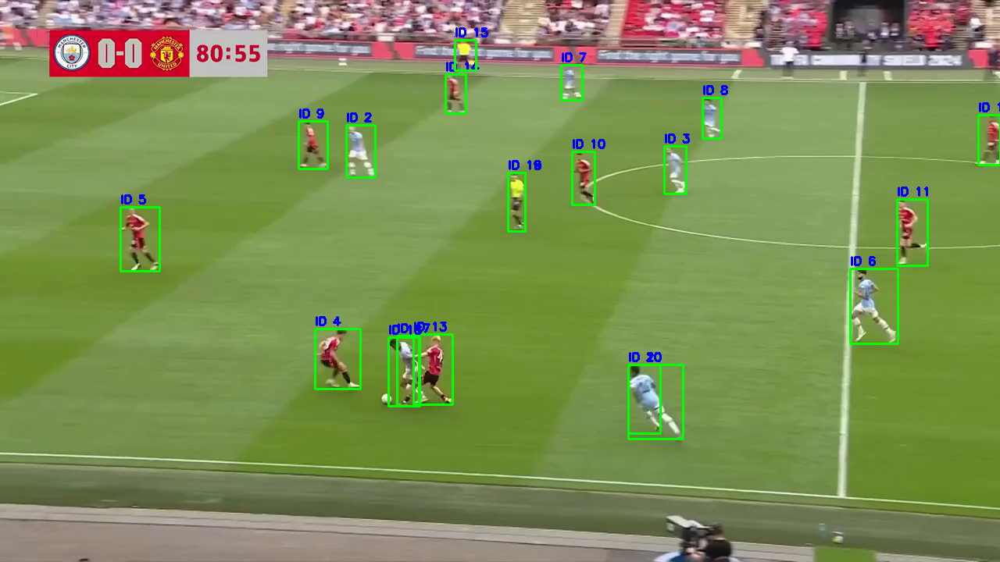


0: 384x640 1 ball, 16 players, 2 referees, 48.7ms
Speed: 2.3ms preprocess, 48.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


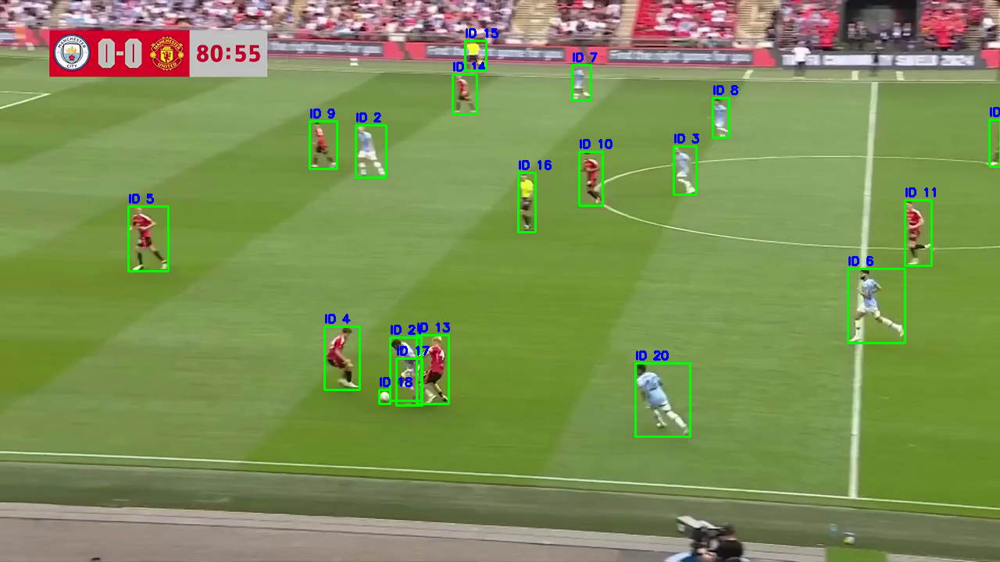


0: 384x640 1 ball, 14 players, 2 referees, 48.7ms
Speed: 2.4ms preprocess, 48.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


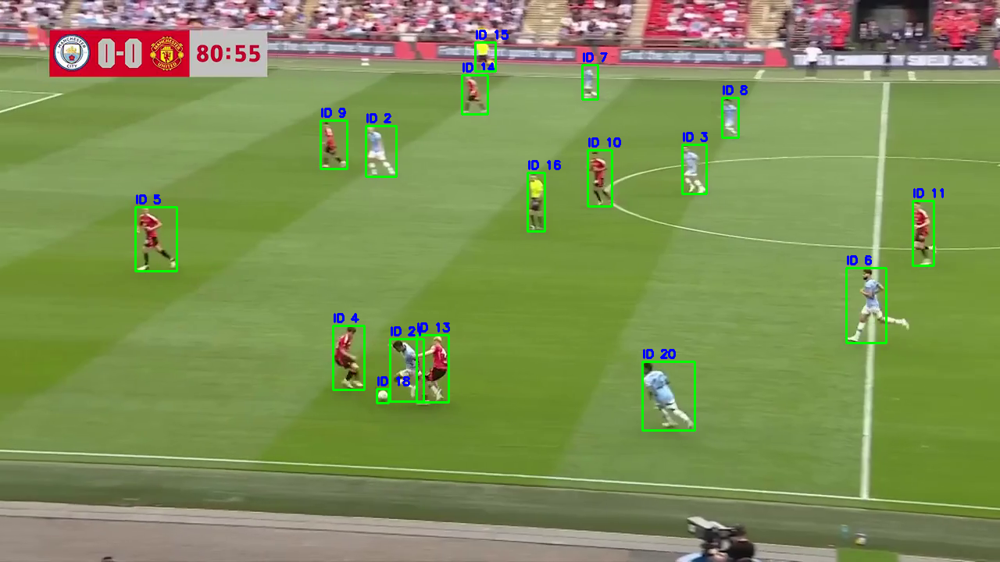


0: 384x640 1 ball, 14 players, 2 referees, 48.7ms
Speed: 2.7ms preprocess, 48.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


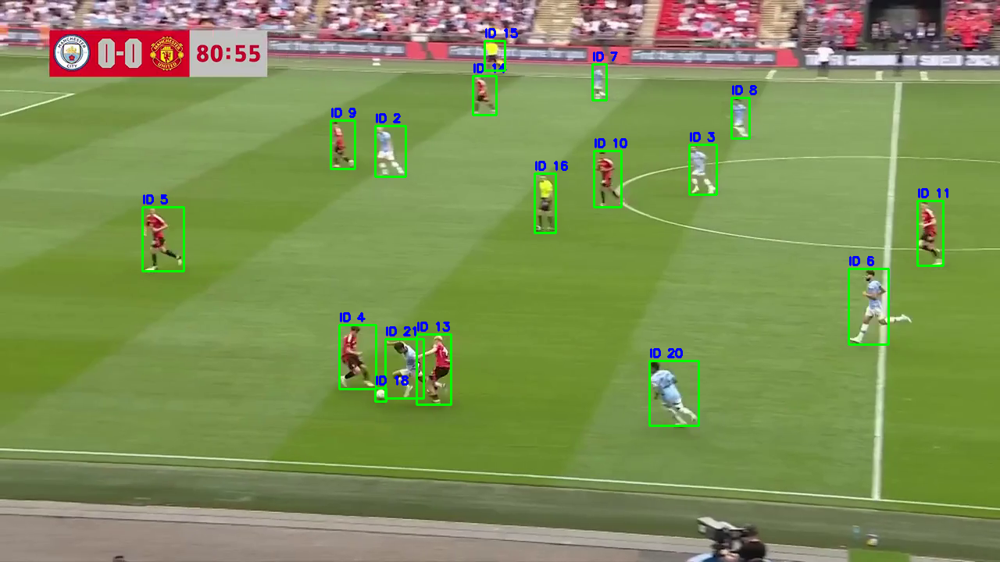


0: 384x640 1 ball, 16 players, 2 referees, 51.6ms
Speed: 2.5ms preprocess, 51.6ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


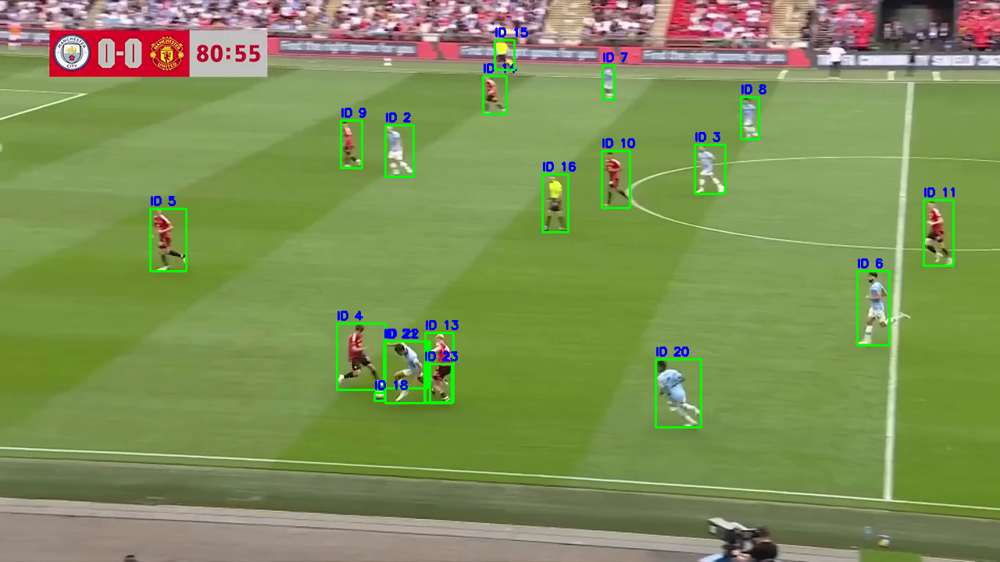


0: 384x640 15 players, 2 referees, 48.7ms
Speed: 2.6ms preprocess, 48.7ms inference, 6.4ms postprocess per image at shape (1, 3, 384, 640)


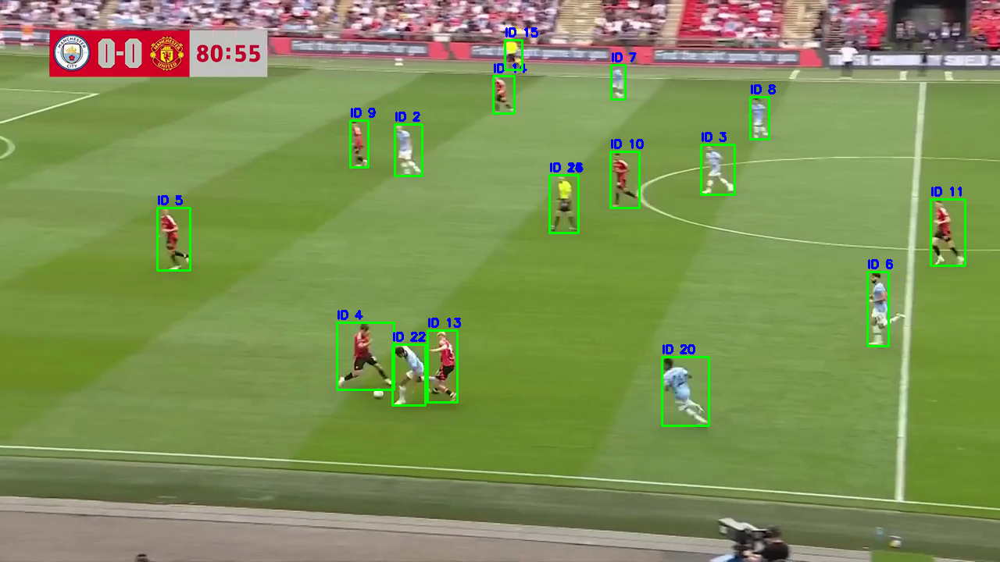


0: 384x640 15 players, 1 referee, 48.7ms
Speed: 2.6ms preprocess, 48.7ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


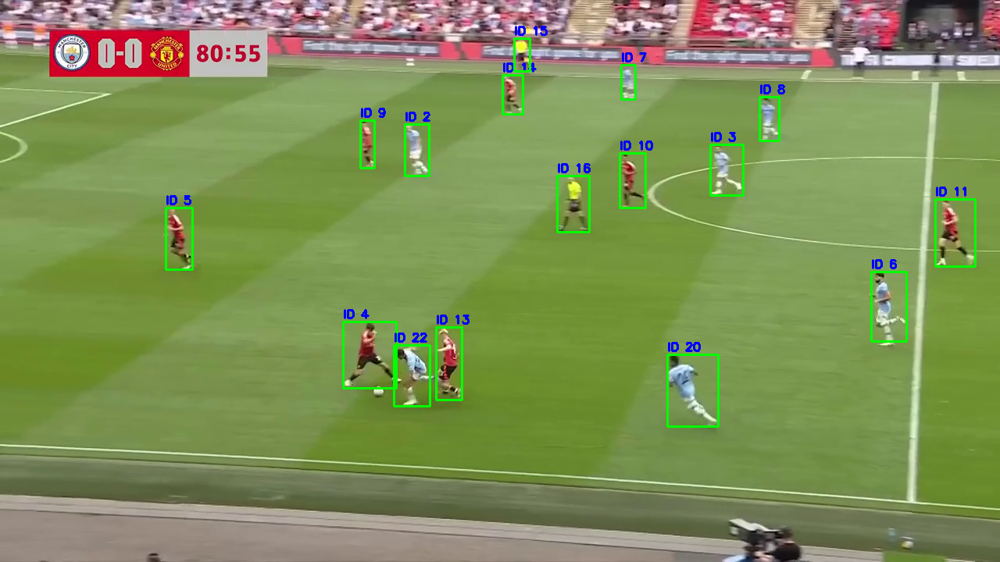


0: 384x640 1 ball, 16 players, 1 referee, 48.7ms
Speed: 2.5ms preprocess, 48.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


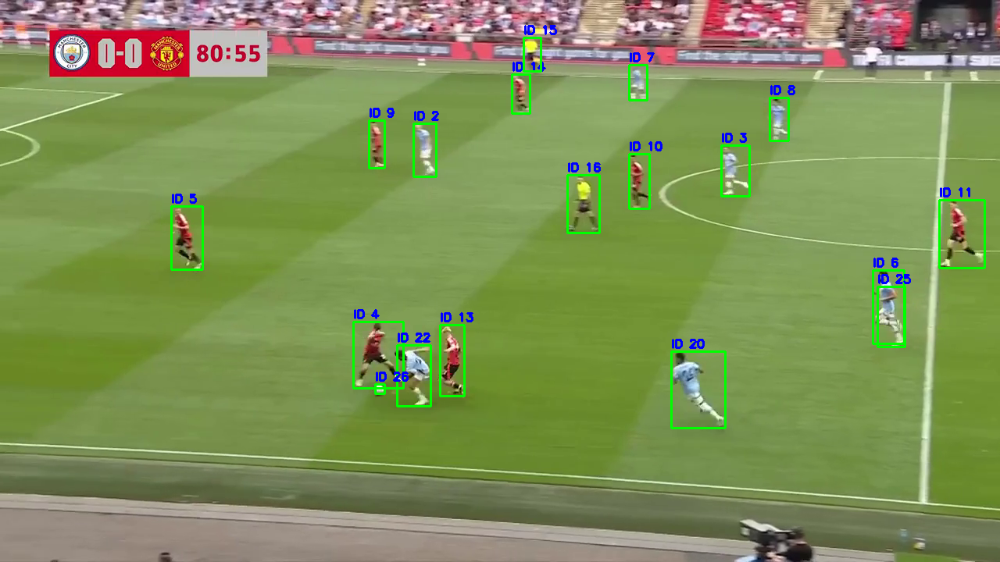


0: 384x640 1 ball, 15 players, 2 referees, 48.7ms
Speed: 2.6ms preprocess, 48.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


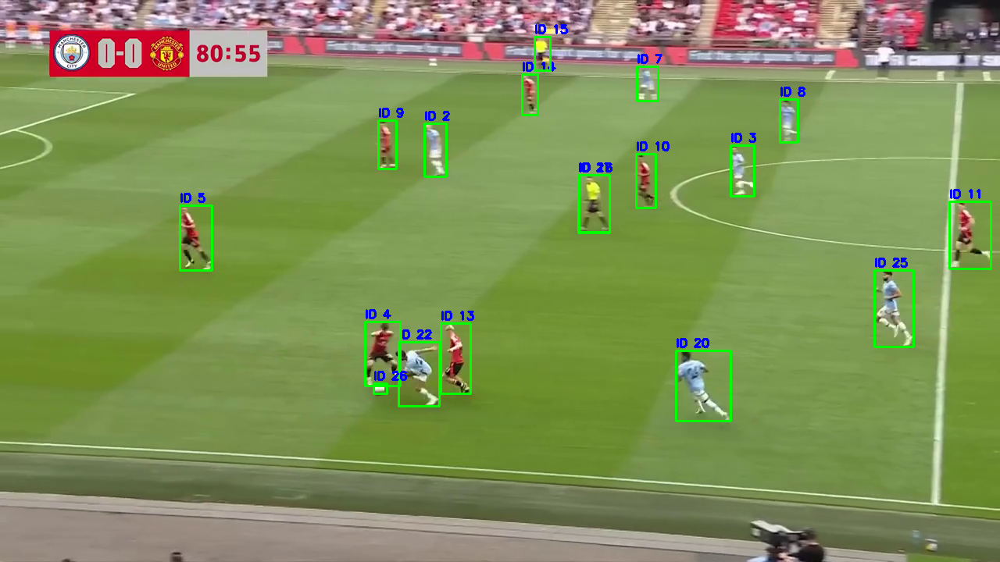


0: 384x640 1 ball, 15 players, 2 referees, 62.9ms
Speed: 3.0ms preprocess, 62.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


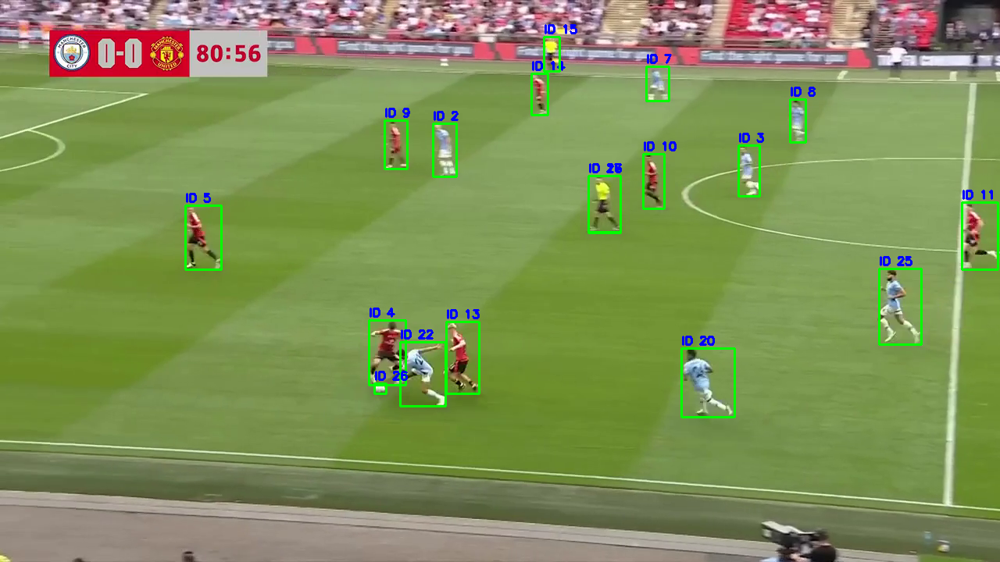


0: 384x640 1 ball, 15 players, 2 referees, 64.2ms
Speed: 2.6ms preprocess, 64.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


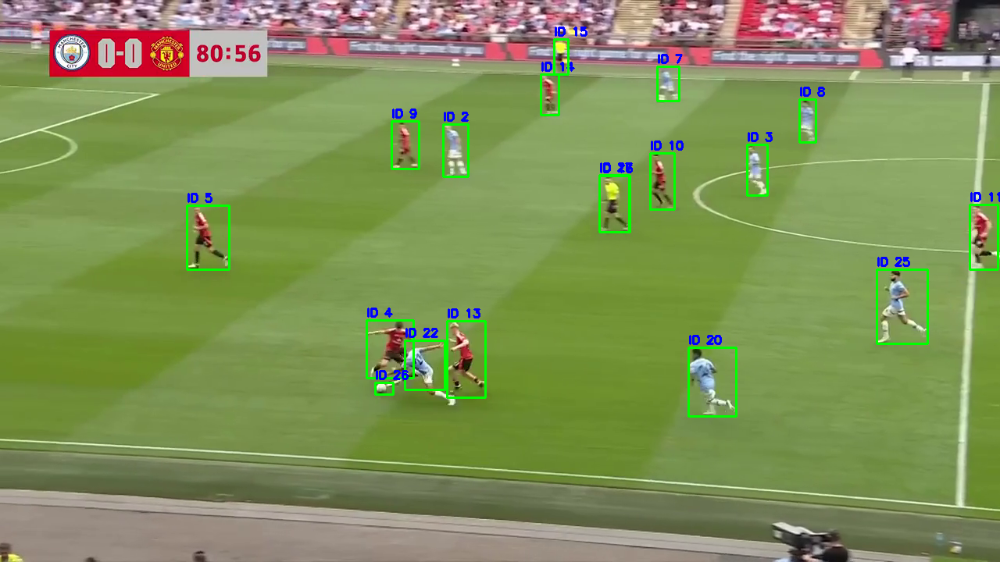

Re-ID demo completed using Hungarian assignment (10 frames).


In [28]:
# Re-ID with Hungarian matching

import math
import numpy as np
from scipy.optimize import linear_sum_assignment
from google.colab.patches import cv2_imshow

def euclidean_distance(p1, p2):
    return np.linalg.norm(np.array(p1) - np.array(p2))

cap = cv2.VideoCapture(video_path)

# Read first frame and initialize
ret, frame = cap.read()
if not ret:
    print("Could not read first frame.")
    cap.release()

results = model(frame)
boxes = results[0].boxes.xyxy.cpu().numpy()
player_centers = []
player_ids = []
id_counter = 1

for box in boxes:
    x1, y1, x2, y2 = box.astype(int)
    cx = int((x1 + x2) / 2)
    cy = int((y1 + y2) / 2)

    player_centers.append((cx, cy))
    player_ids.append(id_counter)
    id_counter += 1

frame_num = 0
while True:
    ret, frame = cap.read()
    if not ret or frame_num > 10:  # limit for demo
        break

    results = model(frame)
    boxes = results[0].boxes.xyxy.cpu().numpy()

    new_centers = []
    new_ids = []

    # Build new centers
    for box in boxes:
        x1, y1, x2, y2 = box.astype(int)
        cx = int((x1 + x2) / 2)
        cy = int((y1 + y2) / 2)
        new_centers.append((cx, cy))

    if len(player_centers) > 0 and len(new_centers) > 0:
        # Compute cost matrix
        cost_matrix = np.zeros((len(player_centers), len(new_centers)))

        for i, prev_c in enumerate(player_centers):
            for j, new_c in enumerate(new_centers):
                cost_matrix[i, j] = euclidean_distance(prev_c, new_c)

        # Solve assignment
        row_idx, col_idx = linear_sum_assignment(cost_matrix)

        # Assign IDs
        assigned_ids = [-1] * len(new_centers)
        for i, j in zip(row_idx, col_idx):
            if cost_matrix[i, j] < 50:  # distance threshold
                assigned_ids[j] = player_ids[i]

        # Assign new IDs to unassigned detections
        for idx in range(len(new_centers)):
            if assigned_ids[idx] == -1:
                assigned_ids[idx] = id_counter
                id_counter += 1

        new_ids = assigned_ids
    else:
        # No previous centers, assign new IDs
        new_ids = [id_counter + i for i in range(len(new_centers))]
        id_counter += len(new_centers)

    # Draw
    for box, pid in zip(boxes, new_ids):
        x1, y1, x2, y2 = box.astype(int)
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f"ID {pid}", (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Update centers and IDs
    player_centers = new_centers
    player_ids = new_ids

    cv2_imshow(frame)

    frame_num += 1

cap.release()
print("Re-ID demo completed using Hungarian assignment (10 frames).")

# Complete Full Video end-to-end Pipeline

Approach 1

In [39]:
import cv2
import shutil
import os

output_video_path = "tracked_output.mp4"

# Re-initialize capture
cap = cv2.VideoCapture("15sec_input_720p.mp4")

# Get proper frame size
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define codec and create VideoWriter
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, 30, (frame_width, frame_height))
print(f"Is VideoWriter opened? {out.isOpened()}")

tracker_memory = {}
next_id = 1
frame_count = 0
max_frames = 360

while True:
    ret, frame = cap.read()
    if not ret or frame_count >= max_frames:
        break

    results = model(frame, verbose=False)[0]
    boxes = results.boxes

    current_detections = []
    for box in boxes:
        cls = int(box.cls)
        if cls == 2:
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            current_detections.append([x1, y1, x2, y2])

    current_ids = []
    assigned_ids = set()

    for det in current_detections:
        best_iou = 0
        best_id = None

        for id_, prev_box in tracker_memory.items():
            ix1 = max(det[0], prev_box[0])
            iy1 = max(det[1], prev_box[1])
            ix2 = min(det[2], prev_box[2])
            iy2 = min(det[3], prev_box[3])
            inter_area = max(0, ix2 - ix1) * max(0, iy2 - iy1)

            det_area = (det[2] - det[0]) * (det[3] - det[1])
            prev_area = (prev_box[2] - prev_box[0]) * (prev_box[3] - prev_box[1])
            union_area = det_area + prev_area - inter_area

            iou = inter_area / union_area if union_area > 0 else 0

            if iou > best_iou and iou > 0.3:
                best_iou = iou
                best_id = id_

        if best_id is not None and best_id not in assigned_ids:
            current_ids.append(best_id)
            assigned_ids.add(best_id)
            tracker_memory[best_id] = det
        else:
            current_ids.append(next_id)
            tracker_memory[next_id] = det
            next_id += 1

    for det, id_ in zip(current_detections, current_ids):
        x1, y1, x2, y2 = det
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f'ID {id_}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    out.write(frame)
    frame_count += 1

print("All frames processed and written to video.")

# Release
out.release()
cap.release()
print("Resources released. Video file should now exist.")

# Move for download
if os.path.exists(output_video_path):
    shutil.move(output_video_path, "/content/tracked_output.mp4")
    print("Moved to /content/tracked_output.mp4 — ready to download!")
else:
    print(f"Error: {output_video_path} not found.")


Is VideoWriter opened? True
All frames processed and written to video.
Resources released. Video file should now exist.
Moved to /content/tracked_output.mp4 — ready to download!


In [40]:
from google.colab import files
files.download('/content/tracked_output.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Enhanced Approach 2 (end-to-end pipeline)**

In [44]:
import cv2
import numpy as np
import shutil
import os
from scipy.optimize import linear_sum_assignment

input_file_path = "15sec_input_720p.mp4"

output_video_path = "tracked_output.mp4"

# Re-initialize capture
cap = cv2.VideoCapture(input_file_path)

# Get proper frame size
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define codec and create VideoWriter
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, 30, (frame_width, frame_height))
print(f"Is VideoWriter opened? {out.isOpened()}")

# Tracker memory
prev_centers = []
prev_ids = []
next_id = 1
frame_count = 0
max_frames = 360

while True:
    ret, frame = cap.read()
    if not ret or frame_count >= max_frames:
        break

    results = model(frame, verbose=False)[0]
    boxes = results.boxes

    current_centers = []
    current_boxes = []

    for box in boxes:
        cls = int(box.cls)
        if cls == 2:
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            cx = int((x1 + x2) / 2)
            cy = int((y1 + y2) / 2)
            current_centers.append((cx, cy))
            current_boxes.append([x1, y1, x2, y2])

    assigned_ids = [-1] * len(current_centers)

    if prev_centers and current_centers:
        cost_matrix = np.zeros((len(prev_centers), len(current_centers)))

        for i, pc in enumerate(prev_centers):
            for j, cc in enumerate(current_centers):
                cost_matrix[i, j] = np.linalg.norm(np.array(pc) - np.array(cc))

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        for r, c in zip(row_ind, col_ind):
            if cost_matrix[r, c] < 50:  # Distance threshold
                assigned_ids[c] = prev_ids[r]

    # Assign new IDs to unmatched detections
    for idx in range(len(assigned_ids)):
        if assigned_ids[idx] == -1:
            assigned_ids[idx] = next_id
            next_id += 1

    # Draw boxes and IDs
    for box, pid in zip(current_boxes, assigned_ids):
        x1, y1, x2, y2 = box
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f'ID {pid}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    # Update memory
    prev_centers = current_centers
    prev_ids = assigned_ids

    out.write(frame)
    frame_count += 1

print("All frames processed and written to video.")

# Release
out.release()
cap.release()
print("Resources released. Video file should now exist.")

# Move for download
if os.path.exists(output_video_path):
    shutil.move(output_video_path, "/content/tracked_output.mp4")
    print("Moved to /content/tracked_output.mp4 — ready to download!")
else:
    print(f"Error: {output_video_path} not found.")


Is VideoWriter opened? True
All frames processed and written to video.
Resources released. Video file should now exist.
Moved to /content/tracked_output.mp4 — ready to download!


In [45]:
from google.colab import files
files.download('/content/tracked_output.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#**Final Approach Nuanced 3 (end-to-end pipeline) W/O Audio**

In [46]:
import cv2
import shutil
import os

# Model path
model_path = "/content/best.pt"

# Load the YOLO model
model = YOLO(model_path)

# Input video
input_video_path = "15sec_input_720p.mp4"
output_video_path = "tracked_output_final.mp4"

# Initialize capture
cap = cv2.VideoCapture(input_video_path)

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
input_fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Create VideoWriter with the same FPS
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, input_fps, (frame_width, frame_height))
print(f"Is VideoWriter opened? {out.isOpened()}")

# Initialize tracker memory
tracker_memory = {}
next_id = 1
frame_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Detect using your model (replace 'model' with your actual model instance)
    results = model(frame, verbose=False)[0]
    boxes = results.boxes

    current_detections = []
    for box in boxes:
        cls = int(box.cls)
        if cls == 2:  # Assuming class 2 = player
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            current_detections.append([x1, y1, x2, y2])

    current_ids = []
    assigned_ids = set()

    for det in current_detections:
        best_iou = 0
        best_id = None

        for id_, prev_box in tracker_memory.items():
            ix1 = max(det[0], prev_box[0])
            iy1 = max(det[1], prev_box[1])
            ix2 = min(det[2], prev_box[2])
            iy2 = min(det[3], prev_box[3])
            inter_area = max(0, ix2 - ix1) * max(0, iy2 - iy1)

            det_area = (det[2] - det[0]) * (det[3] - det[1])
            prev_area = (prev_box[2] - prev_box[0]) * (prev_box[3] - prev_box[1])
            union_area = det_area + prev_area - inter_area

            iou = inter_area / union_area if union_area > 0 else 0

            if iou > best_iou and iou > 0.3:
                best_iou = iou
                best_id = id_

        if best_id is not None and best_id not in assigned_ids:
            current_ids.append(best_id)
            assigned_ids.add(best_id)
            tracker_memory[best_id] = det
        else:
            current_ids.append(next_id)
            tracker_memory[next_id] = det
            next_id += 1

    for det, id_ in zip(current_detections, current_ids):
        x1, y1, x2, y2 = det
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f'ID {id_}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    out.write(frame)
    frame_count += 1

print("All frames processed and written to video.")

# Release resources
out.release()
cap.release()
print("Resources released. Video file should now exist.")

# Move video to root for download
if os.path.exists(output_video_path):
    shutil.move(output_video_path, "/content/tracked_output_final.mp4")
    print("Moved to /content/tracked_output_final.mp4 — ready to download!")
else:
    print(f"Error: {output_video_path} not found.")


Is VideoWriter opened? True
All frames processed and written to video.
Resources released. Video file should now exist.
Moved to /content/tracked_output_final.mp4 — ready to download!


In [47]:
from google.colab import files
files.download('/content/tracked_output_final.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#**Final Approach Nuanced 3 (end-to-end pipeline) with Audio**

In [ ]:
import cv2
import shutil
import os

# Model path
model_path = "/content/best.pt"

# Load the YOLO model
model = YOLO(model_path)

# Input video
input_video_path = "15sec_input_720p.mp4"
output_video_path = "tracked_output_final.mp4"

# Initialize capture
cap = cv2.VideoCapture(input_video_path)

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
input_fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Create VideoWriter with the same FPS
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, input_fps, (frame_width, frame_height))
print(f"Is VideoWriter opened? {out.isOpened()}")

# Initialize tracker memory
tracker_memory = {}
next_id = 1
frame_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Detect using your model (replace 'model' with your actual model instance)
    results = model(frame, verbose=False)[0]
    boxes = results.boxes

    current_detections = []
    for box in boxes:
        cls = int(box.cls)
        if cls == 2:  # Assuming class 2 = player
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            current_detections.append([x1, y1, x2, y2])

    current_ids = []
    assigned_ids = set()

    for det in current_detections:
        best_iou = 0
        best_id = None

        for id_, prev_box in tracker_memory.items():
            ix1 = max(det[0], prev_box[0])
            iy1 = max(det[1], prev_box[1])
            ix2 = min(det[2], prev_box[2])
            iy2 = min(det[3], prev_box[3])
            inter_area = max(0, ix2 - ix1) * max(0, iy2 - iy1)

            det_area = (det[2] - det[0]) * (det[3] - det[1])
            prev_area = (prev_box[2] - prev_box[0]) * (prev_box[3] - prev_box[1])
            union_area = det_area + prev_area - inter_area

            iou = inter_area / union_area if union_area > 0 else 0

            if iou > best_iou and iou > 0.3:
                best_iou = iou
                best_id = id_

        if best_id is not None and best_id not in assigned_ids:
            current_ids.append(best_id)
            assigned_ids.add(best_id)
            tracker_memory[best_id] = det
        else:
            current_ids.append(next_id)
            tracker_memory[next_id] = det
            next_id += 1

    for det, id_ in zip(current_detections, current_ids):
        x1, y1, x2, y2 = det
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f'ID {id_}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    out.write(frame)
    frame_count += 1

print("All frames processed and written to video.")

# Release resources
out.release()
cap.release()
print("Resources released. Video file should now exist.")

# Move video to root for download
if os.path.exists(output_video_path):
    shutil.move(output_video_path, "/content/tracked_output_final.mp4")
    print("Moved to /content/tracked_output_final.mp4 — ready to download!")
else:
    print(f"Error: {output_video_path} not found.")


In [49]:
!apt-get install -y ffmpeg


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 35 not upgraded.


In [50]:
!ffmpeg -i tracked_output_final.mp4 -i 15sec_input_720p.mp4 -c copy -map 0:v:0 -map 1:a:0 -shortest final_tracked_with_audio.mp4


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [51]:
from google.colab import files
files.download('/content/final_tracked_with_audio.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>